In [1]:
import pandas as pd
import warnings
warnings.filterwarnings('ignore')

import locale
# Utilisation de la langue locale de la machine
locale.setlocale(locale.LC_ALL, 'fr_FR')
from datetime import datetime

# Module pour le prétraitement des données textuelles
import re
import spacy
# Charge le petit pipeline français
nlp = spacy.load("fr_core_news_md")

# Analyser le sentiment des commentaires
from textblob import TextBlob
# Module pour la prise en charge de la langue française
from textblob_fr import PatternTagger, PatternAnalyzer

# Visualisation
import seaborn as sns
from matplotlib import pyplot as plt

In [2]:
data = pd.read_json("prototype_data.json")

In [3]:
df = data.copy()
df

,_id,url,image_url,nb_reviewers,price,rating,remark,title
0,{'$oid': '62253386e9189e43d8d20d37'},https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,NaN,4.7,"[{'date': ['13 février 2017', '23 octobre 2016...",HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...
1,{'$oid': '62253556e9189e43d8d26d77'},https://www.amazon.fr/HP-cartouches-couleurs-a...,https://m.media-amazon.com/images/I/81kun2ZZt+...,69773,NaN,4.6,"[{'date': ['18 novembre 2016', '14 mai 2017', ...",HP 301 Pack de 2 Cartouches d'Encre Noire et T...
2,{'$oid': '62253747e9189e43d8d2d40c'},https://www.amazon.fr/Crucial-CT480BX500SSD1-I...,https://m.media-amazon.com/images/I/5167zXL7nk...,22163,NaN,4.7,"[{'date': ['20 novembre 2018', '17 septembre 2...",Crucial BX500 480Go CT480BX500SSD1 SSD Interne...
3,{'$oid': '622538d5e9189e43d8d32236'},https://www.amazon.fr/TP-Link-Archer-T3U-adapt...,https://m.media-amazon.com/images/I/51LsYUMKHb...,15516,NaN,4.4,"[{'date': ['17 juillet 2020', '3 mai 2019', '8...","TP-Link Clé WiFi Puissante AC1300 Mbps, adapta..."
4,{'$oid': '62253a95e9189e43d8d37cae'},https://www.amazon.fr/SanDisk-Ultra-allant-jus...,https://m.media-amazon.com/images/I/51sFovQ2j9...,24326,NaN,4.6,"[{'date': ['13 mars 2020', '17 mars 2018', '4 ...","SanDisk Ultra Flair 64 Go Clé USB 3.0 , dotée ..."
5,{'$oid': '62253ccce9189e43d8d3eb4d'},https://www.amazon.fr/TP-Link-Compatibilit%C3%...,https://m.media-amazon.com/images/I/61AsBGHFJa...,118126,NaN,4.1,"[{'date': ['28 novembre 2019', '14 septembre 2...","TP-Link Répéteur WiFi(TL-WA850RE), Amplificate..."
6,{'$oid': '62253dfae9189e43d8d45489'},https://www.amazon.fr/Crucial-CT1000P2SSD8-Int...,https://m.media-amazon.com/images/I/61KtVwSJSG...,14003,NaN,4.7,"[{'date': ['28 mai 2020', '13 décembre 2020', ...","Crucial P2 CT1000P2SSD8 SSD Interne 1To, Vites..."
7,{'$oid': '62253fc6e9189e43d8d4b52d'},https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,NaN,4.7,"[{'date': ['13 juin 2019', '13 octobre 2020', ...",TP-Link SG105 Switch Ethernet Gigabit 5 ports ...


## Nettoyage des données

In [4]:
# Formatage de l'id
df['_id']=df['_id'].apply(lambda x: x['$oid'])
df

,_id,url,image_url,nb_reviewers,price,rating,remark,title
0,62253386e9189e43d8d20d37,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,NaN,4.7,"[{'date': ['13 février 2017', '23 octobre 2016...",HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...
1,62253556e9189e43d8d26d77,https://www.amazon.fr/HP-cartouches-couleurs-a...,https://m.media-amazon.com/images/I/81kun2ZZt+...,69773,NaN,4.6,"[{'date': ['18 novembre 2016', '14 mai 2017', ...",HP 301 Pack de 2 Cartouches d'Encre Noire et T...
2,62253747e9189e43d8d2d40c,https://www.amazon.fr/Crucial-CT480BX500SSD1-I...,https://m.media-amazon.com/images/I/5167zXL7nk...,22163,NaN,4.7,"[{'date': ['20 novembre 2018', '17 septembre 2...",Crucial BX500 480Go CT480BX500SSD1 SSD Interne...
3,622538d5e9189e43d8d32236,https://www.amazon.fr/TP-Link-Archer-T3U-adapt...,https://m.media-amazon.com/images/I/51LsYUMKHb...,15516,NaN,4.4,"[{'date': ['17 juillet 2020', '3 mai 2019', '8...","TP-Link Clé WiFi Puissante AC1300 Mbps, adapta..."
4,62253a95e9189e43d8d37cae,https://www.amazon.fr/SanDisk-Ultra-allant-jus...,https://m.media-amazon.com/images/I/51sFovQ2j9...,24326,NaN,4.6,"[{'date': ['13 mars 2020', '17 mars 2018', '4 ...","SanDisk Ultra Flair 64 Go Clé USB 3.0 , dotée ..."
5,62253ccce9189e43d8d3eb4d,https://www.amazon.fr/TP-Link-Compatibilit%C3%...,https://m.media-amazon.com/images/I/61AsBGHFJa...,118126,NaN,4.1,"[{'date': ['28 novembre 2019', '14 septembre 2...","TP-Link Répéteur WiFi(TL-WA850RE), Amplificate..."
6,62253dfae9189e43d8d45489,https://www.amazon.fr/Crucial-CT1000P2SSD8-Int...,https://m.media-amazon.com/images/I/61KtVwSJSG...,14003,NaN,4.7,"[{'date': ['28 mai 2020', '13 décembre 2020', ...","Crucial P2 CT1000P2SSD8 SSD Interne 1To, Vites..."
7,62253fc6e9189e43d8d4b52d,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,NaN,4.7,"[{'date': ['13 juin 2019', '13 octobre 2020', ...",TP-Link SG105 Switch Ethernet Gigabit 5 ports ...


### Réorganiser le dataset
Pour avoir un dataset qui affiche un commentaire par ligne

In [5]:
def remaningProductComments(col: list):
    frame = {}
    df_out = None
    # df_shape = len(col)

    # On boucle pour effectuer des transformations sur chaque ligne de commentaire
    for item in col:
        comments = item
        for key, value in comments.items():
            # print(key)
            frame[key] = value
        df_int = pd.DataFrame(frame)

        # On sauvegarde les informations les unes à la suite des autres
        if df_out is not None:
            df_out = pd.concat([df_out, df_int], axis=0, ignore_index=True)
        else:
            df_out = df_int
    return df_out

In [6]:
def remainingDataFrame(df_in):
    df_shape = df_in.shape[0]
    df_out = None

    for i in range(df_shape):
        _id, product_title, product_url, comments = df_in['_id'][i], df_in['title'][i], df_in['url'][i], df_in['remark'][i]
        image_url, nb_reviewers, rating = df_in['image_url'][i], df_in['nb_reviewers'][i], df_in['rating'][i]

        comment_item_df = remaningProductComments(col=comments)

        comment_item_df = comment_item_df.assign(_id=_id)
        comment_item_df['product_title'] = product_title
        comment_item_df['product_url'] = product_url
        comment_item_df['image_url'] = image_url
        comment_item_df['nb_reviewers'] = nb_reviewers
        comment_item_df['rating'] = rating

        if df_out is not None:
            df_out = pd.concat([df_out, comment_item_df], axis=0, ignore_index=True)
        else:
            df_out = comment_item_df
    return df_out.rename(columns={'body': 'comment'})

In [7]:
new_df = remainingDataFrame(df)
new_df

,date,region,comment,_id,product_title,product_url,image_url,nb_reviewers,rating
0,13 février 2017,France,aujourd'hui je voulais remplacer ma cartouche ...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7
1,23 octobre 2016,France,Attention. La dernière cartouche que j'ai ache...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7
2,26 avril 2019,France,Après avoir lu plusieur commentaire négatif j'...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7
3,22 avril 2019,France,"J'ai commandé en Décembre 2 cartouches, reçu r...",62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7
4,19 mars 2017,France,J ai acheter 2 cartouches chez ce vendeur une ...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7
...,...,...,...,...,...,...,...,...,...
37080,4 juillet 2019,Espagne,Buena presencia de acabados y funciona bien p...,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7
37081,27 septembre 2021,Allemagne,es funktioniert,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7
37082,29 août 2019,Italie,Ottimo prodotto fa il suo dovere facile da ins...,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7
37083,15 janvier 2021,Espagne,"Perfecto, evitas pasar cables del rooter con u...",62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7


### Trier les commentaires
Pou ne garder que les commentaires en français

In [8]:
# Eliminer les commentaires vides
def emptyComment(comment):
    return '' if comment is None else comment

In [9]:
# On récupère uniquement les commentaires venant de la France
df_clean = new_df[new_df['region']=='France']
# On supprime les commentaires vides
df_clean['comment'] = df_clean['comment'].apply(emptyComment)
df_clean = df_clean[df_clean['comment']!='']
df_clean

,date,region,comment,_id,product_title,product_url,image_url,nb_reviewers,rating
0,13 février 2017,France,aujourd'hui je voulais remplacer ma cartouche ...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7
1,23 octobre 2016,France,Attention. La dernière cartouche que j'ai ache...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7
2,26 avril 2019,France,Après avoir lu plusieur commentaire négatif j'...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7
3,22 avril 2019,France,"J'ai commandé en Décembre 2 cartouches, reçu r...",62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7
4,19 mars 2017,France,J ai acheter 2 cartouches chez ce vendeur une ...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7
...,...,...,...,...,...,...,...,...,...
33690,10 novembre 2020,France,Tres bien sans problème,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7
33691,7 juillet 2018,France,Nickel fonctionne parfaitement,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7
33692,2 septembre 2017,France,Excellent switch Ethernet ! Cela fait maintena...,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7
33693,3 décembre 2021,France,"Resistant et pas chère, rien a redire pour le ...",62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7


### Transformation du type de la colonne date
en vue de le rendre compréhensible par python pour une future sauvegarde en base de données

In [10]:
def paerse_date(dateString):
    dateFormatter = '%d %B %Y'
    now = datetime.strptime(dateString, dateFormatter)
    return now.strftime("%d-%m-%Y")

In [11]:
df_clean['date'] = df_clean['date'].apply(paerse_date)
df_clean

,date,region,comment,_id,product_title,product_url,image_url,nb_reviewers,rating
0,13-02-2017,France,aujourd'hui je voulais remplacer ma cartouche ...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7
1,23-10-2016,France,Attention. La dernière cartouche que j'ai ache...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7
2,26-04-2019,France,Après avoir lu plusieur commentaire négatif j'...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7
3,22-04-2019,France,"J'ai commandé en Décembre 2 cartouches, reçu r...",62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7
4,19-03-2017,France,J ai acheter 2 cartouches chez ce vendeur une ...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7
...,...,...,...,...,...,...,...,...,...
33690,10-11-2020,France,Tres bien sans problème,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7
33691,07-07-2018,France,Nickel fonctionne parfaitement,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7
33692,02-09-2017,France,Excellent switch Ethernet ! Cela fait maintena...,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7
33693,03-12-2021,France,"Resistant et pas chère, rien a redire pour le ...",62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7


### Retraire des emojis et caractères spéciaux

In [12]:
def nlp_pipeline(text):

    text = text.lower()
    text = text.replace('\n', ' ').replace('\r', '')
    text = ' '.join(text.split())
    text = re.sub(r"[A-Za-z\.]*[0-9]+[A-Za-z%°\.]*", "", text)
    text = re.sub(r"(\s\-\s|-$)", "", text)
    text = re.sub(r"[,\!\?\%\(\)\/\"]", "", text)
    text = re.sub(r"\&\S*\s", "", text)
    text = re.sub(r"\&", "", text)
    text = re.sub(r"\+", "", text)
    text = re.sub(r"\#", "", text)
    text = re.sub(r"\$", "", text)
    text = re.sub(r"\£", "", text)
    text = re.sub(r"\%", "", text)
    text = re.sub(r"\:", "", text)
    text = re.sub(r"\@", "", text)
    text = re.sub(r"\-", " ", text)

    return text

In [13]:
# Ajour d'une nouvelle colonne pour les commentaires nettoyés
clear_comment = []
for comment in df_clean['comment']:
    clear_comment.append(nlp_pipeline(comment))
df_clean['clear_comment'] = clear_comment
df_clean

,date,region,comment,_id,product_title,product_url,image_url,nb_reviewers,rating,clear_comment
0,13-02-2017,France,aujourd'hui je voulais remplacer ma cartouche ...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,aujourd'hui je voulais remplacer ma cartouche ...
1,23-10-2016,France,Attention. La dernière cartouche que j'ai ache...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,attention. la dernière cartouche que j'ai ache...
2,26-04-2019,France,Après avoir lu plusieur commentaire négatif j'...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,après avoir lu plusieur commentaire négatif j'...
3,22-04-2019,France,"J'ai commandé en Décembre 2 cartouches, reçu r...",62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,j'ai commandé en décembre cartouches reçu rap...
4,19-03-2017,France,J ai acheter 2 cartouches chez ce vendeur une ...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,j ai acheter cartouches chez ce vendeur une n...
...,...,...,...,...,...,...,...,...,...,...
33690,10-11-2020,France,Tres bien sans problème,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,tres bien sans problème
33691,07-07-2018,France,Nickel fonctionne parfaitement,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,nickel fonctionne parfaitement
33692,02-09-2017,France,Excellent switch Ethernet ! Cela fait maintena...,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,excellent switch ethernet cela fait maintenan...
33693,03-12-2021,France,"Resistant et pas chère, rien a redire pour le ...",62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,resistant et pas chère rien a redire pour le prix


### Analyser le sentiment des commentaires avec TextBlob

- TextBlob renvoie la polarité et la subjectivité d'une phrase. La polarité se situe entre [-1,1], -1 définit un

    sentiment négatif et 1 définit un sentiment positif. Les mots de négation inversent la polarité. TextBlob a des étiquettes

    sémantiques qui aident à une analyse fine. Par exemple - émoticônes, point d'exclamation, emojis, etc.

- La subjectivité se situe entre [0,1]. La subjectivité quantifie la quantité d'opinions personnelles et

    d'informations factuelles contenues dans le texte. La plus grande subjectivité signifie que le texte contient

    une opinion personnelle plutôt que des informations factuelles .

In [14]:
polarity = []
subjectivity = []
for tweet in df_clean['clear_comment']:
    pola, sub = TextBlob(tweet,pos_tagger=PatternTagger(),analyzer=PatternAnalyzer()).sentiment
    polarity.append(pola); subjectivity.append(sub)

df_clean['polarity'] = polarity
df_clean['subjectivity'] = subjectivity
df_clean

,date,region,comment,_id,product_title,product_url,image_url,nb_reviewers,rating,clear_comment,polarity,subjectivity
0,13-02-2017,France,aujourd'hui je voulais remplacer ma cartouche ...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,aujourd'hui je voulais remplacer ma cartouche ...,0.050000,0.333333
1,23-10-2016,France,Attention. La dernière cartouche que j'ai ache...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,attention. la dernière cartouche que j'ai ache...,-0.290000,0.200000
2,26-04-2019,France,Après avoir lu plusieur commentaire négatif j'...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,après avoir lu plusieur commentaire négatif j'...,0.000000,0.500000
3,22-04-2019,France,"J'ai commandé en Décembre 2 cartouches, reçu r...",62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,j'ai commandé en décembre cartouches reçu rap...,0.045000,0.157500
4,19-03-2017,France,J ai acheter 2 cartouches chez ce vendeur une ...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,j ai acheter cartouches chez ce vendeur une n...,0.016000,0.378000
...,...,...,...,...,...,...,...,...,...,...,...,...
33690,10-11-2020,France,Tres bien sans problème,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,tres bien sans problème,0.000000,0.400000
33691,07-07-2018,France,Nickel fonctionne parfaitement,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,nickel fonctionne parfaitement,0.375000,0.600000
33692,02-09-2017,France,Excellent switch Ethernet ! Cela fait maintena...,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,excellent switch ethernet cela fait maintenan...,0.322222,0.338889
33693,03-12-2021,France,"Resistant et pas chère, rien a redire pour le ...",62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,resistant et pas chère rien a redire pour le prix,-0.002500,0.095000


### Lematisation et tokenization des commentaires avec spacy
Retraire des stop_word et de la ponctuation

In [15]:
def cleanToken(sentence: str):
        """
        Applique un pipeline de nettoyage à la phrase
        :param sentences:
        :type sentences: str
        :return: sentence
        :rtype: str
        """

        doc = nlp(sentence.strip())
        allowed_postags = ['DET', 'PRON']

        # return ' '.join(words)
        return ' '.join(
            token.lemma_ for token in doc
            if token.is_stop is not True and token.is_punct is not True
            and token.tag_ not in allowed_postags and token.like_num is not True
            and token.text is not ' '
        )

In [17]:
df_clean['clear_comment'] = df_clean['clear_comment'].apply(cleanToken)
df_clean

,date,region,comment,_id,product_title,product_url,image_url,nb_reviewers,rating,clear_comment,polarity,subjectivity
0,13-02-2017,France,aujourd'hui je voulais remplacer ma cartouche ...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,aujourd'hui vouloir remplacer cartouche imprim...,0.050000,0.333333
1,23-10-2016,France,Attention. La dernière cartouche que j'ai ache...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,attention dernier cartouche acheter imprimant ...,-0.290000,0.200000
2,26-04-2019,France,Après avoir lu plusieur commentaire négatif j'...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,lire commentaire négatif peur finalement raiso...,0.000000,0.500000
3,22-04-2019,France,"J'ai commandé en Décembre 2 cartouches, reçu r...",62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,commander décembre cartouche recevoir rapideme...,0.045000,0.157500
4,19-03-2017,France,J ai acheter 2 cartouches chez ce vendeur une ...,62253386e9189e43d8d20d37,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,acheter cartouche vendeur noir couleur fonctio...,0.016000,0.378000
...,...,...,...,...,...,...,...,...,...,...,...,...
33690,10-11-2020,France,Tres bien sans problème,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,bien problème,0.000000,0.400000
33691,07-07-2018,France,Nickel fonctionne parfaitement,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,nickel fonctionne parfaitement,0.375000,0.600000
33692,02-09-2017,France,Excellent switch Ethernet ! Cela fait maintena...,62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,excellent switch ethernet mois utiliser foncti...,0.322222,0.338889
33693,03-12-2021,France,"Resistant et pas chère, rien a redire pour le ...",62253fc6e9189e43d8d4b52d,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,resister cher redire prix,-0.002500,0.095000


In [18]:
# Verifier s'il n'y a pas de commentaires vide
df_clean.isna().count()

date             14875
region           14875
comment          14875
_id              14875
product_title    14875
product_url      14875
image_url        14875
nb_reviewers     14875
rating           14875
clear_comment    14875
polarity         14875
subjectivity     14875
dtype: int64

### Visualisation des commentaires par produit

In [19]:
from dataprep.eda import plot_missing

  0%|          | 0/162 [00:00<?, ?it/s]


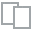
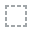
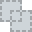
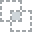
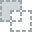
...
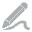
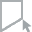
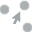
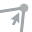
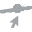

In [20]:
plot_missing(df_clean)

### Nombre de commentaires par produit (Français)

In [21]:
# Création d'un tableau croisé pour compter le nombre de commentaires par produit
df_count = df_clean.groupby('_id').clear_comment.count()
frame = {'_id': df_count.index, 'comments_count': df_count.values}
df_count = pd.DataFrame(frame)
df_count

,_id,comments_count
0,62253386e9189e43d8d20d37,2796
1,62253556e9189e43d8d26d77,3585
2,62253747e9189e43d8d2d40c,1104
3,622538d5e9189e43d8d32236,1049
4,62253a95e9189e43d8d37cae,431
5,62253ccce9189e43d8d3eb4d,3792
6,62253dfae9189e43d8d45489,533
7,62253fc6e9189e43d8d4b52d,1585


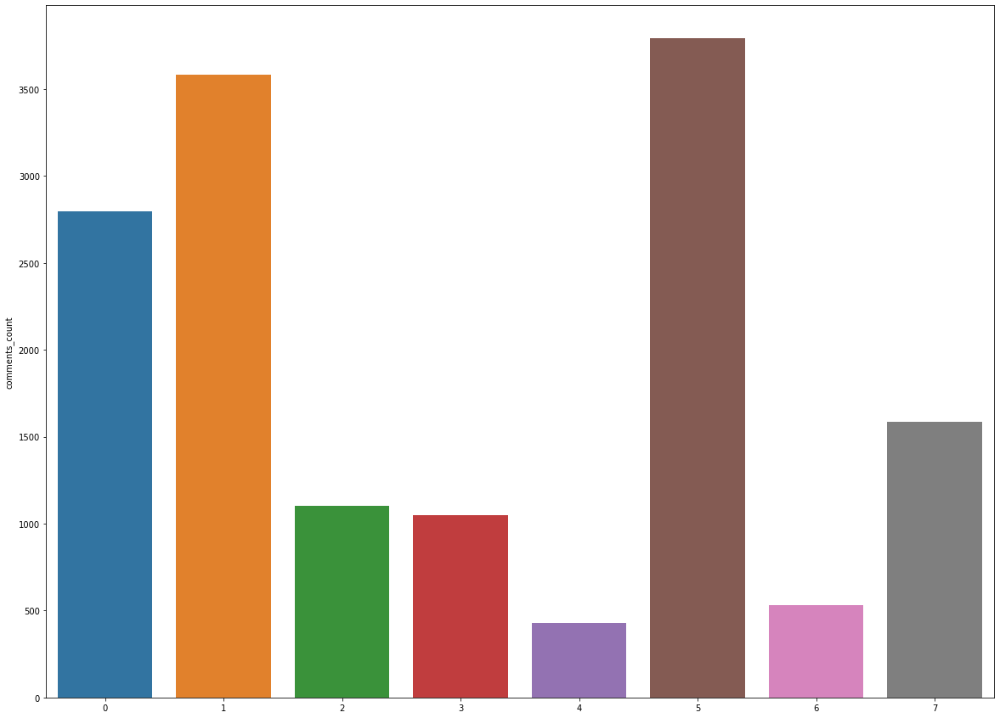

In [22]:
# Set the figure size
plt.figure(figsize=(20, 15))

# grouped barplot
sns.barplot(x=df_count.index, y="comments_count", data=df_count, ci=None);

In [24]:
# On ne garde que les produits dont les commentaires sont supérieurs
df_suite = df_count[df_count['comments_count']>400]
df_suite

,_id,comments_count
0,62253386e9189e43d8d20d37,2796
1,62253556e9189e43d8d26d77,3585
2,62253747e9189e43d8d2d40c,1104
3,622538d5e9189e43d8d32236,1049
4,62253a95e9189e43d8d37cae,431
5,62253ccce9189e43d8d3eb4d,3792
6,62253dfae9189e43d8d45489,533
7,62253fc6e9189e43d8d4b52d,1585


Casement tous les produits ont plus de 500 commentaires


In [26]:
df = pd.merge(df_suite, df_clean, how="inner", on='_id')
df

,_id,comments_count,date,region,comment,product_title,product_url,image_url,nb_reviewers,rating,clear_comment,polarity,subjectivity
0,62253386e9189e43d8d20d37,2796,13-02-2017,France,aujourd'hui je voulais remplacer ma cartouche ...,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,aujourd'hui vouloir remplacer cartouche imprim...,0.050000,0.333333
1,62253386e9189e43d8d20d37,2796,23-10-2016,France,Attention. La dernière cartouche que j'ai ache...,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,attention dernier cartouche acheter imprimant ...,-0.290000,0.200000
2,62253386e9189e43d8d20d37,2796,26-04-2019,France,Après avoir lu plusieur commentaire négatif j'...,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,lire commentaire négatif peur finalement raiso...,0.000000,0.500000
3,62253386e9189e43d8d20d37,2796,22-04-2019,France,"J'ai commandé en Décembre 2 cartouches, reçu r...",HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,commander décembre cartouche recevoir rapideme...,0.045000,0.157500
4,62253386e9189e43d8d20d37,2796,19-03-2017,France,J ai acheter 2 cartouches chez ce vendeur une ...,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,acheter cartouche vendeur noir couleur fonctio...,0.016000,0.378000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
14870,62253fc6e9189e43d8d4b52d,1585,10-11-2020,France,Tres bien sans problème,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,bien problème,0.000000,0.400000
14871,62253fc6e9189e43d8d4b52d,1585,07-07-2018,France,Nickel fonctionne parfaitement,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,nickel fonctionne parfaitement,0.375000,0.600000
14872,62253fc6e9189e43d8d4b52d,1585,02-09-2017,France,Excellent switch Ethernet ! Cela fait maintena...,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,excellent switch ethernet mois utiliser foncti...,0.322222,0.338889
14873,62253fc6e9189e43d8d4b52d,1585,03-12-2021,France,"Resistant et pas chère, rien a redire pour le ...",TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,resister cher redire prix,-0.002500,0.095000


## Regroupement Thématique des commentaires

In [31]:
from commind_lda_modeling import TopicModeling

### Créer le dictionnaire et le corpus nécessaires à la modélisation thématique

In [32]:
comments = df['clear_comment'].to_list()
print(comments[0])

aujourd'hui vouloir remplacer cartouche imprimant détecte indique cartouche problème savoir acheter couleur fonctionne bien decu arrive joindre vendeur


In [33]:
def strToList(string):
    return string.split()

comments = []
comments.append(df_clean['clear_comment'].apply(strToList).to_list())
comments[0]

[["aujourd'hui",
  'vouloir',
  'remplacer',
  'cartouche',
  'imprimant',
  'détecte',
  'indique',
  'cartouche',
  'problème',
  'savoir',
  'acheter',
  'couleur',
  'fonctionne',
  'bien',
  'decu',
  'arrive',
  'joindre',
  'vendeur'],
 ['attention',
  'dernier',
  'cartouche',
  'acheter',
  'imprimant',
  'vouloir',
  'prendre',
  'incompatible',
  'argent',
  'jeter',
  'ppubelle'],
 ['lire',
  'commentaire',
  'négatif',
  'peur',
  'finalement',
  'raison',
  'cartouche',
  'parfait',
  'comprendre',
  'vraiment',
  'commentaire',
  'négatif',
  'imprimante'],
 ['commander',
  'décembre',
  'cartouche',
  'recevoir',
  'rapidement',
  'installer',
  'cartouche',
  'décembre',
  'bien',
  'fonctionner',
  'hier',
  'imprimant',
  'indique',
  'falloir',
  'changer',
  'cartouche',
  'noir',
  'impression',
  'cartouche',
  'remplir',
  'moitié',
  'mettre',
  'cartouche',
  'carrément',
  'vide',
  'bien',
  'reconnaître',
  'imprimant',
  'impression',
  'souhaite',
  'dédo

In [34]:
# comments = df['clear_comment'].to_list()
topic_model = TopicModeling(list_sentences=comments[0])

adding document #0 to Dictionary(0 unique tokens: [])
adding document #10000 to Dictionary(9498 unique tokens: ['acheter', 'arrive', "aujourd'hui", 'bien', 'cartouche']...)
built Dictionary(13082 unique tokens: ['acheter', 'arrive', "aujourd'hui", 'bien', 'cartouche']...) from 14875 documents (total 153280 corpus positions)
Dictionary lifecycle event {'msg': 'built Dictionary(13082 unique tokens: [\'acheter\', \'arrive\', "aujourd\'hui", \'bien\', \'cartouche\']...) from 14875 documents (total 153280 corpus positions)', 'datetime': '2022-04-01T10:36:59.230969', 'gensim': '4.1.2', 'python': '3.8.8 (tags/v3.8.8:024d805, Feb 19 2021, 13:18:16) [MSC v.1928 64 bit (AMD64)]', 'platform': 'Windows-10-10.0.22000-SP0', 'event': 'created'}


### Visualiser un extrait de la fréquence des mots

In [35]:
topic_model.viewFreqWord()

[[('acheter', 1), ('arrive', 1), ("aujourd'hui", 1), ('bien', 1), ('cartouche', 2), ('couleur', 1), ('decu', 1), ('détecte', 1), ('fonctionne', 1), ('imprimant', 1), ('indique', 1), ('joindre', 1), ('problème', 1), ('remplacer', 1), ('savoir', 1), ('vendeur', 1), ('vouloir', 1)]]


### Recherche du nombre optimal de sujets

In [36]:
model_list, coherence_values = topic_model.compute_coherence_values()

using symmetric alpha at 0.5
using symmetric eta at 0.5
using serial LDA version on this node
running online (single-pass) LDA training, 2 topics, 1 passes over the supplied corpus of 14875 documents, updating model once every 2000 documents, evaluating perplexity every 14875 documents, iterating 50x with a convergence threshold of 0.001000
too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
PROGRESS: pass 0, at document #2000/14875
merging changes from 2000 documents into a model of 14875 documents
topic #0 (0.500): 0.045*"cartouche" + 0.035*"bon" + 0.035*"produit" + 0.024*"bien" + 0.023*"qualité" + 0.022*"imprimant" + 0.019*"prix" + 0.017*"impression" + 0.015*"parfait" + 0.015*"conforme"
topic #1 (0.500): 0.065*"cartouche" + 0.021*"encre" + 0.017*"bien" + 0.017*"hp" + 0.017*"cher" + 0.016*"bon" + 0.016*"imprimant" + 0.015*"qualité" + 0.015*"prix" + 0.014*"acheter"
topic diff=2.743665, rho=1.000000
PROGRESS: pass 0, 

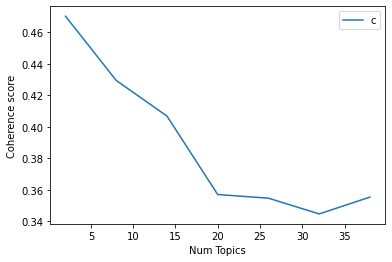

In [38]:
x = topic_model.numTopicGraph(coherence_values=coherence_values)

In [39]:
num_topic =  topic_model.getBestNumTopic(coherence_values=coherence_values)
num_topic

Num Topic: 8  coherence score: 0.4293


1

In [40]:
optimal_model = topic_model.getOptimalModele(model_list=model_list, num_topic=1)
optimal_model

topic #0 (0.125): 0.037*"switch" + 0.034*"petit" + 0.032*"port" + 0.017*"réseau" + 0.015*"vitesse" + 0.014*"wifi" + 0.013*"ethernet" + 0.012*"faire" + 0.011*"gigabit" + 0.011*"notice"
topic #1 (0.125): 0.044*"connexion" + 0.041*"bon" + 0.030*"wifi" + 0.029*"simple" + 0.027*"maison" + 0.023*"top" + 0.022*"prise" + 0.017*"installation" + 0.015*"répéteur" + 0.015*"produit"
topic #2 (0.125): 0.082*"bien" + 0.057*"fonctionne" + 0.030*"connecter" + 0.018*"parfaitement" + 0.015*"appareil" + 0.014*"installer" + 0.013*"acheter" + 0.012*"marche" + 0.010*"mettre" + 0.010*"installation"
topic #3 (0.125): 0.047*"prix" + 0.043*"bon" + 0.039*"qualité" + 0.029*"rapport" + 0.021*"pc" + 0.014*"box" + 0.013*"cher" + 0.010*"ras" + 0.010*"installer" + 0.010*"ordinateur"
topic #4 (0.125): 0.094*"box" + 0.047*"conforme" + 0.046*"produit" + 0.045*"parfait" + 0.028*"rapide" + 0.025*"répéteur" + 0.023*"excellent" + 0.019*"description" + 0.019*"attente" + 0.017*"recommande"
topic #5 (0.125): 0.034*"boitier" + 0.

[(0,
  '0.037*"switch" + 0.034*"petit" + 0.032*"port" + 0.017*"réseau" + '
  '0.015*"vitesse" + 0.014*"wifi" + 0.013*"ethernet" + 0.012*"faire" + '
  '0.011*"gigabit" + 0.011*"notice"'),
 (1,
  '0.044*"connexion" + 0.041*"bon" + 0.030*"wifi" + 0.029*"simple" + '
  '0.027*"maison" + 0.023*"top" + 0.022*"prise" + 0.017*"installation" + '
  '0.015*"répéteur" + 0.015*"produit"'),
 (2,
  '0.082*"bien" + 0.057*"fonctionne" + 0.030*"connecter" + '
  '0.018*"parfaitement" + 0.015*"appareil" + 0.014*"installer" + '
  '0.013*"acheter" + 0.012*"marche" + 0.010*"mettre" + 0.010*"installation"'),
 (3,
  '0.047*"prix" + 0.043*"bon" + 0.039*"qualité" + 0.029*"rapport" + 0.021*"pc" '
  '+ 0.014*"box" + 0.013*"cher" + 0.010*"ras" + 0.010*"installer" + '
  '0.010*"ordinateur"'),
 (4,
  '0.094*"box" + 0.047*"conforme" + 0.046*"produit" + 0.045*"parfait" + '
  '0.028*"rapide" + 0.025*"répéteur" + 0.023*"excellent" + 0.019*"description" '
  '+ 0.019*"attente" + 0.017*"recommande"'),
 (5,
  '0.034*"boitier"

### Construction du modèle

In [41]:
lda_model = topic_model.makeLdaModel(num_topics=3)
topic_model.viewMetric(lda_model)

using autotuned alpha, starting with [0.33333334, 0.33333334, 0.33333334]
using symmetric eta at 0.3333333333333333
using serial LDA version on this node
running online (multi-pass) LDA training, 3 topics, 10 passes over the supplied corpus of 14875 documents, updating model once every 100 documents, evaluating perplexity every 1000 documents, iterating 50x with a convergence threshold of 0.001000
PROGRESS: pass 0, at document #100/14875
optimized alpha [0.35500887, 0.38229057, 0.3712489]
merging changes from 100 documents into a model of 14875 documents
topic #0 (0.355): 0.069*"cartouche" + 0.029*"imprimant" + 0.023*"bien" + 0.022*"prix" + 0.016*"hp" + 0.012*"qualité" + 0.012*"fonctionne" + 0.012*"amazon" + 0.012*"couleur" + 0.012*"impression"
topic #1 (0.382): 0.059*"cartouche" + 0.036*"imprimant" + 0.020*"encre" + 0.019*"bien" + 0.014*"acheter" + 0.012*"fois" + 0.011*"qualité" + 0.011*"hp" + 0.011*"bon" + 0.011*"produit"
topic #2 (0.371): 0.086*"cartouche" + 0.028*"imprimant" + 0.02


Perplexity:  -7.775278102337832


7 accumulators retrieved from output queue
accumulated word occurrence stats for 14108 virtual documents



Coherence Score:  0.5155913550906911


In [42]:
davis = topic_model.showGraph(lda_model=lda_model)
davis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0     -0.178076  0.223747       1        1  38.358050
2     -0.130708 -0.247863       2        1  34.459045
1      0.308783  0.024115       3        1  27.182904, topic_info=              Term         Freq        Total Category  logprob  loglift
3             bien  2652.000000  2652.000000  Default  30.0000  30.0000
58             bon  2400.000000  2400.000000  Default  29.0000  29.0000
55         produit  2145.000000  2145.000000  Default  28.0000  28.0000
8       fonctionne  2065.000000  2065.000000  Default  27.0000  27.0000
77          facile  1550.000000  1550.000000  Default  26.0000  26.0000
...            ...          ...          ...      ...      ...      ...
8       fonctionne  1981.441736  2065.468793   Topic3  -3.0459   1.2610
43       installer  1098.595518  1348.283050   Topic3  -3.6357   1.0978
6772       discret   264.084253   276.156539   Topic3  -5.0612   1.2579
171         simple   529.804579   895.096124   Topic3  -4.3649   0.7782
255   installation   357.813887   961.176008   Topic3  -4.7574   0.3144

[153 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
0         1  0.999361   acheter
120       1  0.997814    amazon
237       2  0.996643    ancien
2450      1  0.006726  appareil
2450      2  0.993259  appareil
...     ...       ...       ...
3673      2  0.993376       web
5447      1  0.996939      wifi
5447      2  0.002836      wifi
5447      3  0.000709      wifi
5196      2  0.997008    window

[177 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 3, 2])

### Trouver le sujet dominant dans chaque phrase


In [52]:
df_topic_sents_keywords = topic_model.getTopicData(ldamodel=lda_model, df=df)
df_topic_sents_keywords

,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,_id,comments_count,date,region,comment,product_title,product_url,image_url,nb_reviewers,rating,clear_comment,polarity,subjectivity
0,0,0,0.6596,"switch, box, réseau, wifi, appareil, simple, a...",aujourd'hui je voulais remplacer ma cartouche ...,62253386e9189e43d8d20d37,2796,13-02-2017,France,aujourd'hui je voulais remplacer ma cartouche ...,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,aujourd'hui vouloir remplacer cartouche imprim...,0.050000,0.333333
1,1,0,0.6063,"switch, box, réseau, wifi, appareil, simple, a...",Attention. La dernière cartouche que j'ai ache...,62253386e9189e43d8d20d37,2796,23-10-2016,France,Attention. La dernière cartouche que j'ai ache...,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,attention dernier cartouche acheter imprimante...,-0.290000,0.200000
2,2,1,0.4960,"bien, fonctionne, facile, installer, port, ins...",Après avoir lu plusieur commentaire négatif j'...,62253386e9189e43d8d20d37,2796,26-04-2019,France,Après avoir lu plusieur commentaire négatif j'...,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,lire commentaire négatif peur finalement raiso...,0.000000,0.500000
3,3,0,0.5356,"switch, box, réseau, wifi, appareil, simple, a...","J'ai commandé en Décembre 2 cartouches, reçu r...",62253386e9189e43d8d20d37,2796,22-04-2019,France,"J'ai commandé en Décembre 2 cartouches, reçu r...",HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,commander décembre cartouche recevoir rapideme...,0.045000,0.157500
4,4,0,0.4955,"switch, box, réseau, wifi, appareil, simple, a...",J ai acheter 2 cartouches chez ce vendeur une ...,62253386e9189e43d8d20d37,2796,19-03-2017,France,J ai acheter 2 cartouches chez ce vendeur une ...,HP 302 Pack de 2 Cartouches d'Encre Noire/Troi...,https://www.amazon.fr/HP-Cartouches-Couleurs-A...,https://m.media-amazon.com/images/I/61dMzR9r8a...,81995,4.7,acheter cartouche vendeur noir couleur fonctio...,0.016000,0.378000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14870,14870,0,0.4979,"switch, box, réseau, wifi, appareil, simple, a...",Tres bien sans problème,62253fc6e9189e43d8d4b52d,1585,10-11-2020,France,Tres bien sans problème,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,bien problème,0.000000,0.400000
14871,14871,1,0.4894,"bien, fonctionne, facile, installer, port, ins...",Nickel fonctionne parfaitement,62253fc6e9189e43d8d4b52d,1585,07-07-2018,France,Nickel fonctionne parfaitement,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,nickel fonctionne parfaitement,0.375000,0.600000
14872,14872,0,0.4848,"switch, box, réseau, wifi, appareil, simple, a...",Excellent switch Ethernet ! Cela fait maintena...,62253fc6e9189e43d8d4b52d,1585,02-09-2017,France,Excellent switch Ethernet ! Cela fait maintena...,TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch-...,https://m.media-amazon.com/images/I/81H18YMLHG...,71207,4.7,excellent switch mois utilise fonctionne bien ...,0.322222,0.338889
14873,14873,2,0.3524,"bon, produit, petit, prix, qualité, recommande...","Resistant et pas chère, rien a redire pour le ...",62253fc6e9189e43d8d4b52d,1585,03-12-2021,France,"Resistant et pas chère, rien a redire pour le ...",TP-Link SG105 Switch Ethernet Gigabit 5 ports ...,https://www.amazon.fr/TP-Link-TL-SG105-Switch

In [57]:
from save_data import save_data

In [59]:
save_data(df_topic_sents_keywords)

Données rajoutées avec succès
{'image_url': 'https://m.media-amazon.com/images/I/61dMzR9r8aL._AC_SX679_.jpg',
 'nb_reviewers': 81995,
 'price': 0.0,
 'product_business_key': '62253386e9189e43d8d20d37',
 'product_rating': 4.7,
 'product_url': 'https://www.amazon.fr/HP-Cartouches-Couleurs-Authentiques-Officejet/dp/B019EIFWLK/ref=zg-bs_computers_1/257-6313485-9093037?pd_rd_w=oFs7Z&pf_rd_p=f492caf8-8007-48d2-883a-38800a772222&pf_rd_r=K7S2T2XYHGSYF9PZZR3Q&pd_rd_r=6b3a3481-0a0d-407f-b873-8f3c7fbfbf73&pd_rd_wg=aqXNP&pd_rd_i=B019EIFWLK&th=1',
 'title': "HP 302 Pack de 2 Cartouches d'Encre Noire/Trois Couleurs "
          'Authentiques pour HP deskjet 2130/3630 et HP Officejet 3830'}
Données rajoutées avec succès
{'date': '13-02-2017',
 'dominant_topic': 0,
 'keyword': 'switch, box, réseau, wifi, appareil, simple, acheter, connecter, '
            'brancher, débit',
 'polarity': 0.049999999999999996,
 'product_id': 1,
 'region': 'France',
 'remark': "aujourd'hui je voulais remplacer ma cartouch